In [52]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [53]:
# Creating a dataframe from the resale dataset
df = pd.read_csv("01_hdb_resale_transactions.csv")

In [54]:
df

,block,street_name,town,postal_code,month,flat_type,storey_range,floor_area_sqm,flat_model,lease_commence_date,resale_price,latitude,longitude,cbd_dist,min_dist_mrt
0,174,ANG MO KIO AVENUE 4,ANG MO KIO,560174,2015-01,3 ROOM,07 TO 09,60.0,Improved,1986,255000.0,1.375097,103.837619,10296.855750,1096.947897
1,541,ANG MO KIO AVENUE 10,ANG MO KIO,560541,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1981,275000.0,1.373922,103.855621,10065.227930,847.235690
2,163,ANG MO KIO AVENUE 4,ANG MO KIO,560163,2015-01,3 ROOM,01 TO 03,69.0,New Generation,1980,285000.0,1.373552,103.838169,10118.831550,1176.742184
3,446,ANG MO KIO AVENUE 10,ANG MO KIO,560446,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1979,290000.0,1.367761,103.855357,9383.300907,682.205473
4,557,ANG MO KIO AVENUE 10,ANG MO KIO,560557,2015-01,3 ROOM,07 TO 09,68.0,New Generation,1980,290000.0,1.371626,103.857736,9825.917255,953.047695
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
194235,362A,SEMBAWANG CRESCENT,SEMBAWANG,751362,2023-07,4 ROOM,16 TO 18,93.0,Model A,2019,560000.0,1.447195,103.814008,18624.123340,702.591563
194236,362A,SEMBAWANG CRESCENT,SEMBAWANG,751362,2023-07,4 ROOM,04 TO 06,93.0,Model A,2019,550000.0,1.447195,103.814008,18624.123340,702.591563
194237,366B,SEMBAWANG CRESCENT,SEMBAWANG,752366,2023-07,4 ROOM,13 TO 15,93.0,Model A,2019,565000.0,1.443922,103.815957,18223.416060,727.108165
194238,992B,BUANGKOK LINK,HOUGANG,532992,2023-07,4 ROOM,07 TO 09,93.0,Model A,2019,598000.0,1.383827,103.881672,11650.037860,1278.633561


# Exploratory Data Analysis

In [55]:
# The information about each column
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194240 entries, 0 to 194239
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   block                194240 non-null  object 
 1   street_name          194240 non-null  object 
 2   town                 194240 non-null  object 
 3   postal_code          194240 non-null  int64  
 4   month                194240 non-null  object 
 5   flat_type            194240 non-null  object 
 6   storey_range         194240 non-null  object 
 7   floor_area_sqm       194240 non-null  float64
 8   flat_model           194240 non-null  object 
 9   lease_commence_date  194240 non-null  int64  
 10  resale_price         194240 non-null  float64
 11  latitude             194240 non-null  float64
 12  longitude            194240 non-null  float64
 13  cbd_dist             194240 non-null  float64
 14  min_dist_mrt         194240 non-null  float64
dtypes: float64(6), in

In [56]:
# Calculating null values for each columns
null_counts = df.isnull().sum()
print(null_counts)

block                  0
street_name            0
town                   0
postal_code            0
month                  0
flat_type              0
storey_range           0
floor_area_sqm         0
flat_model             0
lease_commence_date    0
resale_price           0
latitude               0
longitude              0
cbd_dist               0
min_dist_mrt           0
dtype: int64


In [57]:
# Displaying "town" column value counts and unique values
print("Towns")
print(df["town"].unique())
print(" ")
print("Value count for each town")
print(df["town"].value_counts())

Towns
['ANG MO KIO' 'BEDOK' 'BISHAN' 'BUKIT BATOK' 'BUKIT MERAH' 'BUKIT PANJANG'
 'BUKIT TIMAH' 'CENTRAL AREA' 'CHOA CHU KANG' 'CLEMENTI' 'GEYLANG'
 'HOUGANG' 'JURONG EAST' 'JURONG WEST' 'KALLANG/WHAMPOA' 'MARINE PARADE'
 'PASIR RIS' 'PUNGGOL' 'QUEENSTOWN' 'SEMBAWANG' 'SENGKANG' 'SERANGOON'
 'TAMPINES' 'TOA PAYOH' 'WOODLANDS' 'YISHUN']
 
Value count for each town
SENGKANG           15812
WOODLANDS          13663
PUNGGOL            13222
TAMPINES           13193
JURONG WEST        13192
YISHUN             12939
BEDOK              10892
HOUGANG             9619
CHOA CHU KANG       8953
ANG MO KIO          8368
BUKIT MERAH         7371
BUKIT PANJANG       7343
BUKIT BATOK         6996
TOA PAYOH           6100
PASIR RIS           5989
KALLANG/WHAMPOA     5864
QUEENSTOWN          5399
SEMBAWANG           5028
GEYLANG             4925
CLEMENTI            4520
JURONG EAST         4066
SERANGOON           3723
BISHAN              3642
CENTRAL AREA        1706
MARINE PARADE       1225
BUKIT TIM

In [58]:
# Displaying "flat_type" column value counts and unique values
print("flat_type")
print(df["flat_type"].unique())
print(" ")
print("Value count for each flat_type")
print(df["flat_type"].value_counts())

flat_type
['3 ROOM' '4 ROOM' '5 ROOM' '2 ROOM' 'EXECUTIVE' '1 ROOM'
 'MULTI-GENERATION']
 
Value count for each flat_type
4 ROOM              81114
5 ROOM              48332
3 ROOM              46951
EXECUTIVE           14820
2 ROOM               2870
MULTI-GENERATION       78
1 ROOM                 75
Name: flat_type, dtype: int64


In [59]:
# Displaying "storey_range" column value counts and unique values
print("storey_range")
print(df["storey_range"].unique())
print(" ")
print("Value count for each storey_range")
print(df["storey_range"].value_counts())

storey_range
['07 TO 09' '01 TO 03' '13 TO 15' '10 TO 12' '04 TO 06' '19 TO 21'
 '16 TO 18' '22 TO 24' '25 TO 27' '28 TO 30' '34 TO 36' '46 TO 48'
 '31 TO 33' '37 TO 39' '43 TO 45' '40 TO 42' '49 TO 51']
 
Value count for each storey_range
04 TO 06    45123
07 TO 09    41188
10 TO 12    36345
01 TO 03    34771
13 TO 15    18184
16 TO 18     8391
19 TO 21     3511
22 TO 24     2551
25 TO 27     1500
28 TO 30      960
31 TO 33      498
34 TO 36      469
37 TO 39      423
40 TO 42      208
43 TO 45       59
46 TO 48       44
49 TO 51       15
Name: storey_range, dtype: int64


In [60]:
# Displaying "flat_model" column value counts and unique values
print("flat_model")
print(df["flat_model"].unique())
print(" ")
print("Value count for each flat_model")
print(df["flat_model"].value_counts())

flat_model
['Improved' 'New Generation' 'Model A' 'Standard' 'Simplified'
 'Premium Apartment' 'Maisonette' 'Apartment' 'Model A2' 'Type S1'
 'Type S2' 'Adjoined flat' 'Terrace' 'DBSS' 'Model A-Maisonette'
 'Premium Maisonette' 'Multi Generation' 'Premium Apartment Loft'
 'Improved-Maisonette' '2-room' '3Gen']
 
Value count for each flat_model
Model A                   64528
Improved                  48510
New Generation            26023
Premium Apartment         21535
Simplified                 7987
Apartment                  7439
Maisonette                 5591
Standard                   5567
DBSS                       2978
Model A2                   2375
Type S1                     414
Model A-Maisonette          358
Adjoined flat               328
Type S2                     207
Terrace                     114
Premium Apartment Loft      100
Multi Generation             78
2-room                       53
Improved-Maisonette          26
Premium Maisonette           16
3Gen          

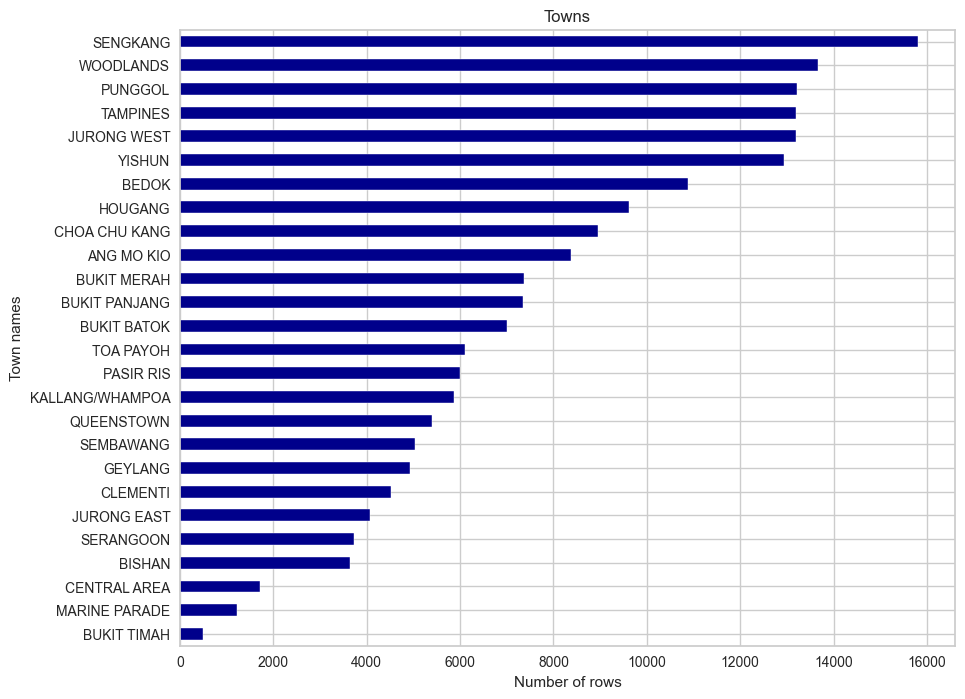

In [61]:
# Value counts for town
town_counts = df['town'].value_counts()

# Sort the value counts in descending order
sorted_town_counts = town_counts.sort_values(ascending=True)

# Create the horizontal bar plot for towns
plt.figure(figsize=(10, 8))
sorted_town_counts.plot.barh(title='Towns', color='DarkBlue')
plt.xlabel("Number of rows")
plt.ylabel("Town names")
plt.show()

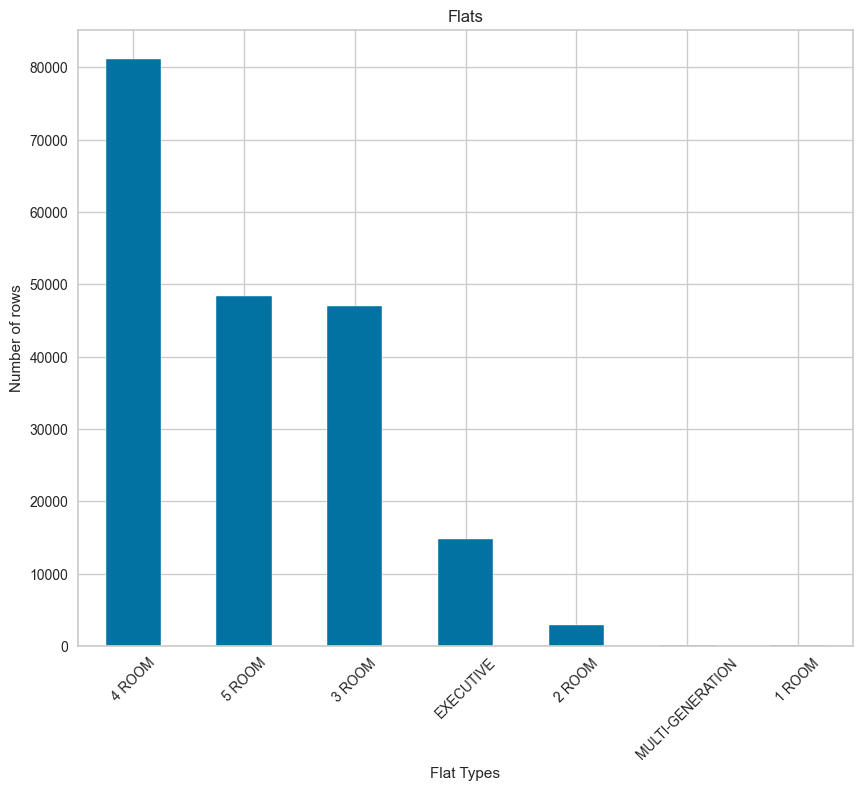

In [62]:
# Value counts for town
flat_counts = df['flat_type'].value_counts()

# Sort the value counts in descending order
sorted_flat_counts = flat_counts.sort_values(ascending=False)

# Create the horizontal bar plot for towns
plt.figure(figsize=(10, 8))
sorted_flat_counts.plot.bar(title='Flats')
plt.xlabel("Flat Types")
plt.ylabel("Number of rows")

plt.xticks(rotation=45)
plt.show()

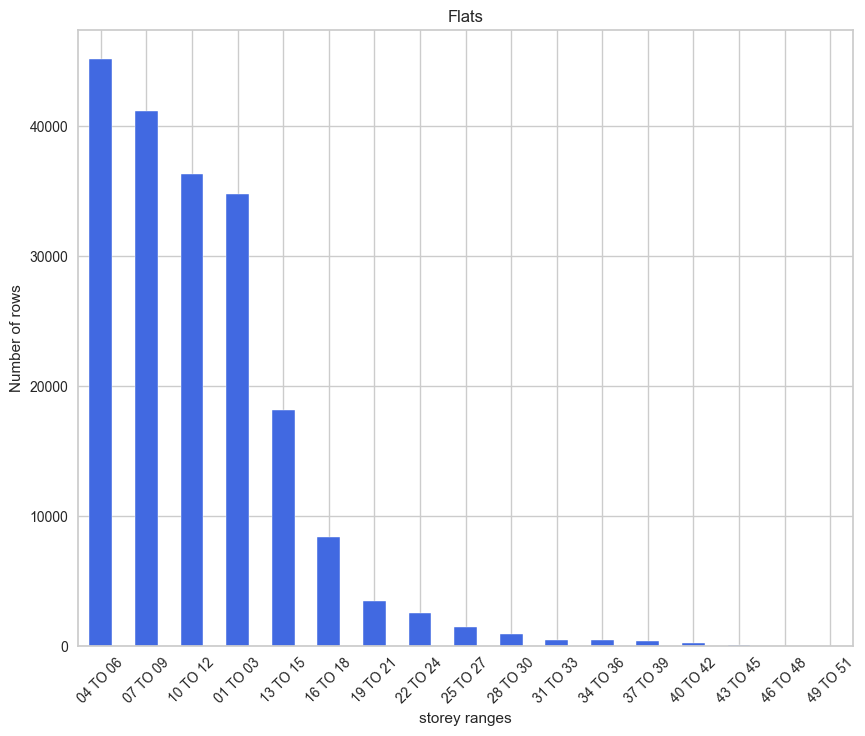

In [63]:
# Value counts for town
storey_range_counts = df['storey_range'].value_counts()

# Sort the value counts in descending order
sorted_storey_range_counts = storey_range_counts.sort_values(ascending=False)

# Create the horizontal bar plot for towns
plt.figure(figsize=(10, 8))
sorted_storey_range_counts.plot.bar(title='Flats', color='#4169E1')
plt.xlabel("storey ranges")
plt.ylabel("Number of rows")

plt.xticks(rotation=45)
plt.show()

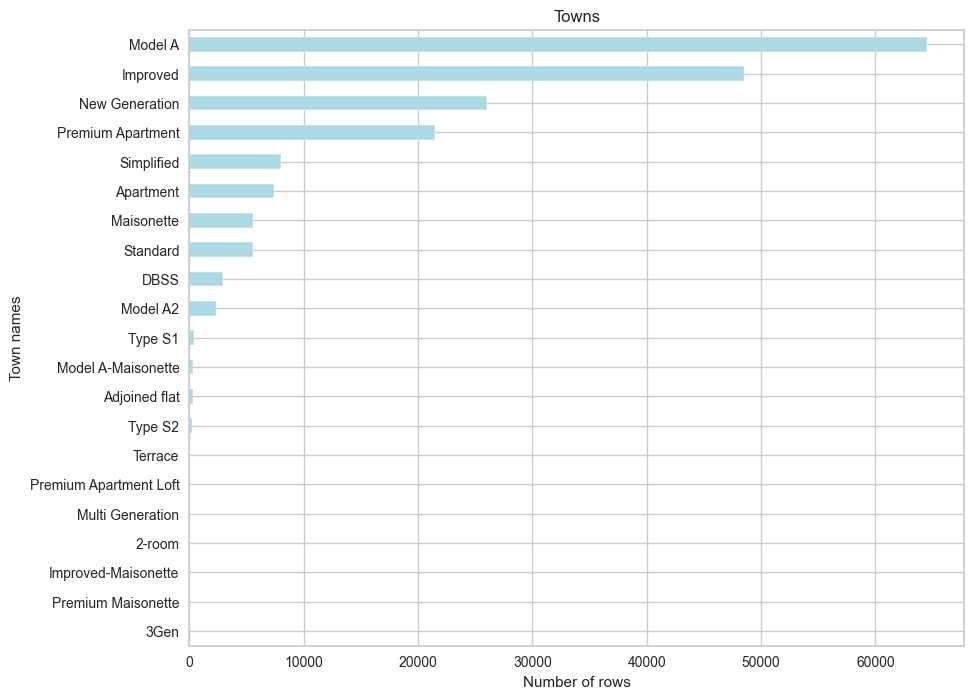

In [64]:
# Value counts for town
flat_model_counts = df['flat_model'].value_counts()

# Sort the value counts in descending order
sorted_flat_model_counts = flat_model_counts.sort_values(ascending=True)

# Create the horizontal bar plot for towns
plt.figure(figsize=(10, 8))
sorted_flat_model_counts.plot.barh(title='Towns', color='lightblue')
plt.xlabel("Number of rows")
plt.ylabel("Town names")
plt.show()

In [65]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194240 entries, 0 to 194239
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   block                194240 non-null  object 
 1   street_name          194240 non-null  object 
 2   town                 194240 non-null  object 
 3   postal_code          194240 non-null  int64  
 4   month                194240 non-null  object 
 5   flat_type            194240 non-null  object 
 6   storey_range         194240 non-null  object 
 7   floor_area_sqm       194240 non-null  float64
 8   flat_model           194240 non-null  object 
 9   lease_commence_date  194240 non-null  int64  
 10  resale_price         194240 non-null  float64
 11  latitude             194240 non-null  float64
 12  longitude            194240 non-null  float64
 13  cbd_dist             194240 non-null  float64
 14  min_dist_mrt         194240 non-null  float64
dtypes: float64(6), in

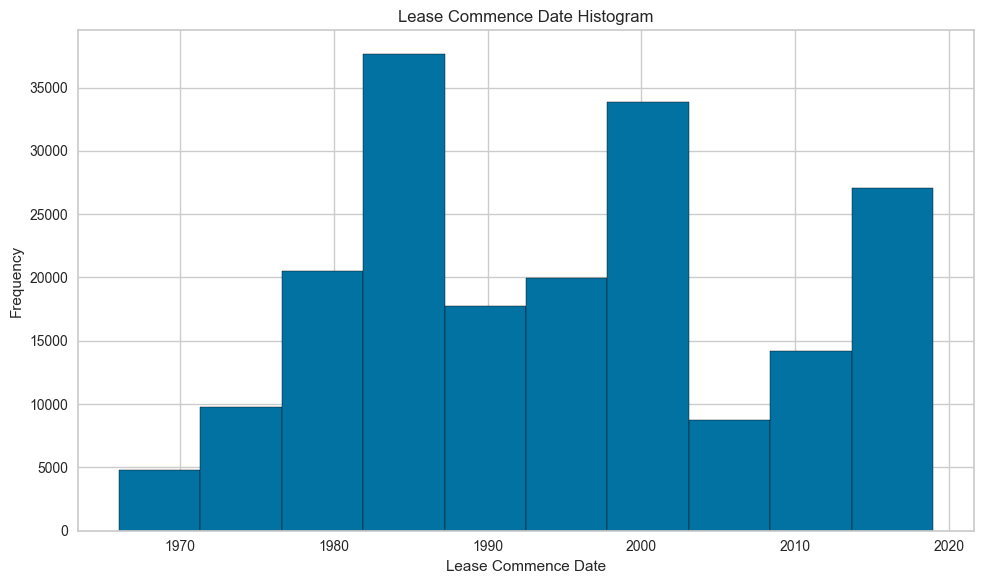

In [66]:
# Create a histogram using Matplotlib
plt.figure(figsize=(10, 6))  # Adjust figure size if needed
plt.hist(df['lease_commence_date'], bins=10, edgecolor='black')
plt.title('Lease Commence Date Histogram')
plt.xlabel('Lease Commence Date')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

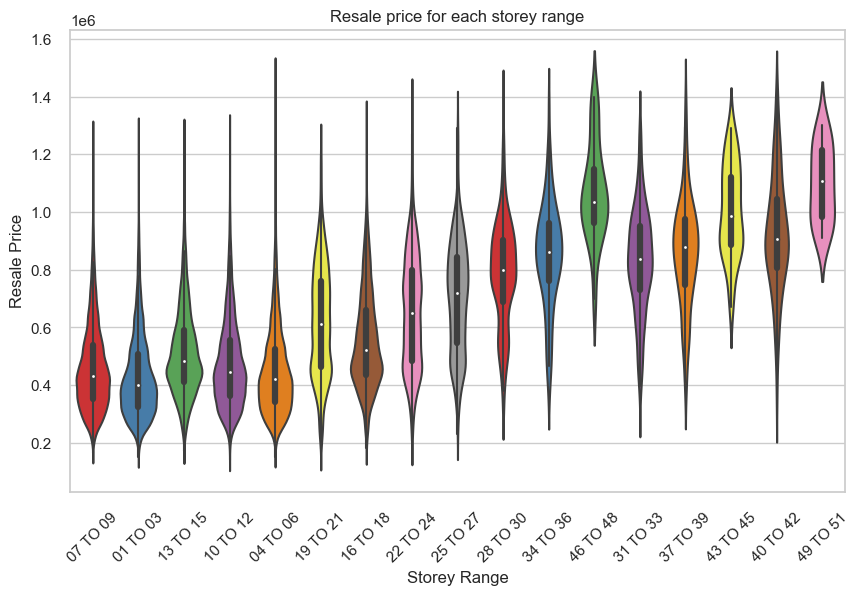

In [67]:
# Set Seaborn style
sns.set(style="whitegrid")
custom_palette = sns.color_palette("Set1", n_colors=len(df))

# Create a violin plot using Seaborn
plt.figure(figsize=(10, 6))
sns.violinplot(x='storey_range', y='resale_price', data=df, palette=custom_palette)
plt.title('Resale price for each storey range')
plt.xlabel('Storey Range')
plt.ylabel('Resale Price')

plt.xticks(rotation=45)
plt.show()

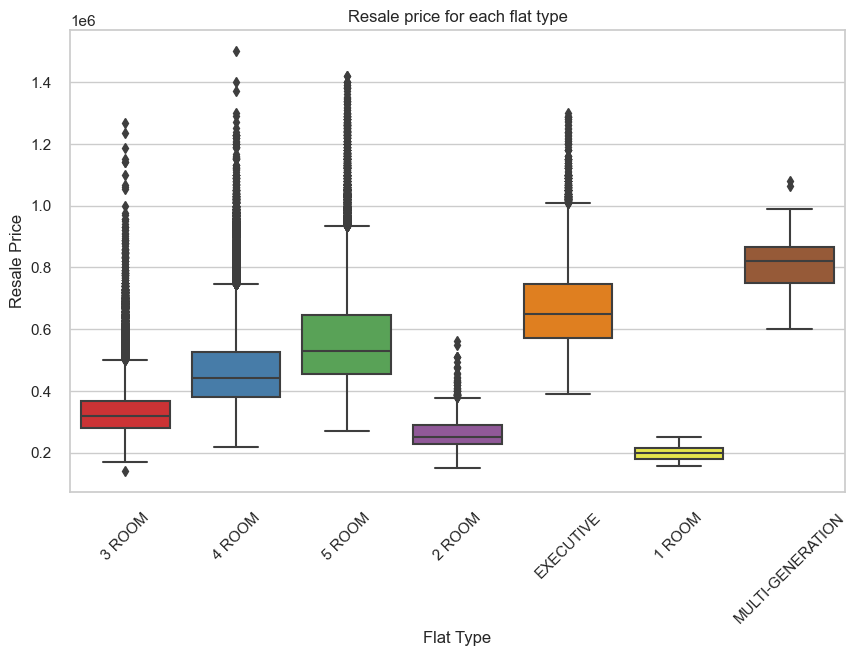

In [68]:
# Set Seaborn style
sns.set(style="whitegrid")
custom_palette = sns.color_palette("Set1", n_colors=len(df))

# Create a violin plot using Seaborn
plt.figure(figsize=(10, 6)) 
sns.boxplot(x='flat_type', y='resale_price', data=df, palette=custom_palette)
plt.title('Resale price for each flat type')
plt.xlabel('Flat Type')
plt.ylabel('Resale Price')

plt.xticks(rotation=45)
plt.show()

In [69]:
fig = px.scatter(x=df['floor_area_sqm'], y=df['resale_price'], opacity = 0.25, trendline='ols', trendline_color_override = 'red')

fig.update_xaxes(title_text='Floor Area (sqm)')
fig.update_yaxes(title_text='Resale Price')

fig.show()

In [70]:
# Calculate the correlation matrix
correlation_matrix = df.corr()

# Create a heatmap for the correlation matrix using Plotly Express
fig = px.imshow(
    correlation_matrix.values,
    x=correlation_matrix.columns,
    y=correlation_matrix.index,
    labels=dict(color="Correlation"),
    color_continuous_scale="RdBu",
    zmin=-1,
    zmax=1,
    title="Correlation Matrix Heatmap for resale dataset"
)

fig.update_xaxes(side="bottom")
fig.update_yaxes(side="right")

# Add text annotations with the correlation values
for i, row in enumerate(correlation_matrix.index):
    for j, col in enumerate(correlation_matrix.columns):
        fig.add_annotation(
            text=f"{correlation_matrix.iloc[i, j]:.2f}",
            x=col,
            y=row,
            showarrow=False,
            font=dict(size=10)
        )

fig.show()

## Data Preparation

In [71]:
import mlflow
mlflow.set_tracking_uri("http://localhost:5000")

In [72]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194240 entries, 0 to 194239
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   block                194240 non-null  object 
 1   street_name          194240 non-null  object 
 2   town                 194240 non-null  object 
 3   postal_code          194240 non-null  int64  
 4   month                194240 non-null  object 
 5   flat_type            194240 non-null  object 
 6   storey_range         194240 non-null  object 
 7   floor_area_sqm       194240 non-null  float64
 8   flat_model           194240 non-null  object 
 9   lease_commence_date  194240 non-null  int64  
 10  resale_price         194240 non-null  float64
 11  latitude             194240 non-null  float64
 12  longitude            194240 non-null  float64
 13  cbd_dist             194240 non-null  float64
 14  min_dist_mrt         194240 non-null  float64
dtypes: float64(6), in

In [73]:
from pycaret.regression import *
df
rgr_resale = setup(data = df, 
                   target = 'resale_price', 
                   transform_target=True, 
                   normalize=True,
                   log_experiment=True,
                   ignore_features=['block', 'street_name', 'postal_code', 'latitude', 'longitude'],
                   remove_outliers = True)

,Description,Value
0,Session id,6239
1,Target,resale_price
2,Target type,Regression
3,Original data shape,"(194240, 15)"
4,Transformed data shape,"(187441, 52)"
5,Transformed train set shape,"(129169, 52)"
6,Transformed test set shape,"(58272, 52)"
7,Ignore features,5
8,Numeric features,4
9,Categorical features,5


2023/08/18 15:57:35 INFO mlflow.tracking.fluent: Experiment with name 'reg-default-name' does not exist. Creating a new experiment.


In [74]:
rgr_resale.get_config('dataset_transformed')

,town,month,flat_type_4 ROOM,flat_type_3 ROOM,flat_type_2 ROOM,flat_type_EXECUTIVE,flat_type_5 ROOM,flat_type_MULTI-GENERATION,flat_type_1 ROOM,storey_range_04 TO 06,...,flat_model_Premium Apartment Loft,flat_model_Adjoined flat,flat_model_Improved-Maisonette,flat_model_2-room,flat_model_Premium Maisonette,flat_model_3Gen,lease_commence_date,cbd_dist,min_dist_mrt,resale_price
18820,-0.405825,-0.880849,1.135508,-0.556279,-0.098972,-0.256351,-0.584511,-0.021377,-0.02026,1.815382,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,-0.863299,0.669497,0.307690,4.255603
49639,2.816518,-0.632998,-0.880663,1.797660,-0.098972,-0.256351,-0.584511,-0.021377,-0.02026,1.815382,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,-0.863299,-2.305965,-1.248493,4.257924
70322,0.802339,-0.745209,-0.880663,1.797660,-0.098972,-0.256351,-0.584511,-0.021377,-0.02026,-0.550848,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,-1.091717,-1.854547,-0.574365,4.241558
119666,1.402088,0.074304,-0.880663,1.797660,-0.098972,-0.256351,-0.584511,-0.021377,-0.02026,-0.550848,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,1.497020,0.417253,-0.946391,4.258969
3492,0.428068,-0.777598,-0.880663,-0.556279,-0.098972,3.900907,-0.584511,-0.021377,-0.02026,-0.550848,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,0.431070,0.167584,-0.990143,4.284217
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167897,-0.874767,1.614930,-0.880663,-0.556279,-0.098972,3.900907,-0.584511,-0.021377,-0.02026,1.815382,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,0.354930,1.215530,-0.387534,4.286836
133205,0.735791,0.596971,1.135508,-0.556279,-0.098972,-0.256351,-0.584511,-0.021377,-0.02026,-0.550848,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,-0.787159,-0.175803,-0.170960,4.259247
96369,-0.405825,-0.990512,-0.880663,-0.556279,-0.098972,3.900907,-0.584511,-0.021377,-0.02026,1.815382,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,-0.178045,0.677211,0.194799,4.276876
15878,-0.826123,-0.557121,1.135508,-0.556279,-0.098972,-0.256351,-0.584511,-0.021377,-0.02026,-0.550848,...,-0.02378,-0.042692,-0.012752,-0.016463,-0.010411,-0.006222,-0.101906,1.477561,0.199975,4.245994


In [75]:
print(f'Ordinal features: {rgr_resale._fxs["Ordinal"]}')
print(f'Numeric features: {rgr_resale._fxs["Numeric"]}')
print(f'Date features: {rgr_resale._fxs["Date"]}')
print(f'Text features: {rgr_resale._fxs["Text"]}')
print(f'Categorical features: {rgr_resale._fxs["Categorical"]}')

Ordinal features: {}
Numeric features: ['floor_area_sqm', 'lease_commence_date', 'cbd_dist', 'min_dist_mrt']
Date features: []
Text features: []
Categorical features: ['town', 'month', 'flat_type', 'storey_range', 'flat_model']


In [76]:
models()

,Name,Reference,Turbo
ID,,,
lr,Linear Regression,sklearn.linear_model._base.LinearRegression,True
lasso,Lasso Regression,sklearn.linear_model._coordinate_descent.Lasso,True
ridge,Ridge Regression,sklearn.linear_model._ridge.Ridge,True
en,Elastic Net,sklearn.linear_model._coordinate_descent.Elast...,True
lar,Least Angle Regression,sklearn.linear_model._least_angle.Lars,True
llar,Lasso Least Angle Regression,sklearn.linear_model._least_angle.LassoLars,True
omp,Orthogonal Matching Pursuit,sklearn.linear_model._omp.OrthogonalMatchingPu...,True
br,Bayesian Ridge,sklearn.linear_model._bayes.BayesianRidge,True
ard,Automatic Relevance Determination,sklearn.linear_model._bayes.ARDRegression,False


In [77]:
best = compare_models(fold = 5)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,20765.4006,859376835.8773,29311.5632,0.9677,0.0588,0.0442,9.0720
xgboost,Extreme Gradient Boosting,22384.2785,1013512448.0000,31830.3652,0.9619,0.0628,0.0471,8.2280
rf,Random Forest Regressor,21913.1634,1042858965.8003,32285.6005,0.9608,0.0638,0.0465,34.0080
et,Extra Trees Regressor,22286.9787,1063553055.2847,32599.5976,0.9601,0.0661,0.0479,173.9600
lightgbm,Light Gradient Boosting Machine,25378.6083,1316101019.6961,36273.4921,0.9506,0.0703,0.0531,2.8180
dt,Decision Tree Regressor,29642.3907,1879827683.3979,43352.2238,0.9294,0.0871,0.0632,0.8020
knn,K Neighbors Regressor,28648.7105,2083341132.8000,45625.3492,0.9218,0.0860,0.0592,5.5540
gbr,Gradient Boosting Regressor,33512.0227,2298071124.7612,47937.3237,0.9137,0.0905,0.0687,9.2840
lr,Linear Regression,41332.0052,3511727102.1341,59203.8077,0.8680,0.1125,0.0864,8.2040
br,Bayesian Ridge,41331.7790,3514913448.8738,59227.8629,0.8679,0.1125,0.0864,1.0940


Processing:   0%|          | 0/85 [00:00<?, ?it/s]

In [78]:
# check the final params of best model
best.get_params()

{'loss_function': 'RMSE',
 'border_count': 254,
 'verbose': False,
 'task_type': 'CPU',
 'random_state': 6239}

In [79]:
best

In [80]:
custom_grid = {
    'loss_function': ['RMSE'],
    'border_count': [254, 128, 512],
    'verbose': [False],
    'task_type': ['CPU'],
    'random_state': [2591]
}

tuned_model = tune_model(best, custom_grid=custom_grid)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,20501.6440,804863790.7236,28370.1214,0.9696,0.0577,0.0438
1,20700.4096,838372050.9959,28954.6551,0.9678,0.0584,0.0441
2,20616.6398,830462383.8951,28817.7443,0.9685,0.0581,0.0438
3,20582.4056,828262610.9354,28779.5520,0.9691,0.0582,0.0437
4,20581.7960,847317094.8771,29108.7117,0.9693,0.0581,0.0437
5,20511.9030,836186117.3385,28916.8829,0.9675,0.0587,0.0439
6,20962.5187,887577760.7881,29792.2433,0.9673,0.0590,0.0444
7,20628.7919,859536485.4184,29317.8527,0.9679,0.0585,0.0440
8,20823.2532,864017803.1361,29394.1797,0.9679,0.0590,0.0442


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 3 candidates, totalling 30 fits


## Model Evaluation

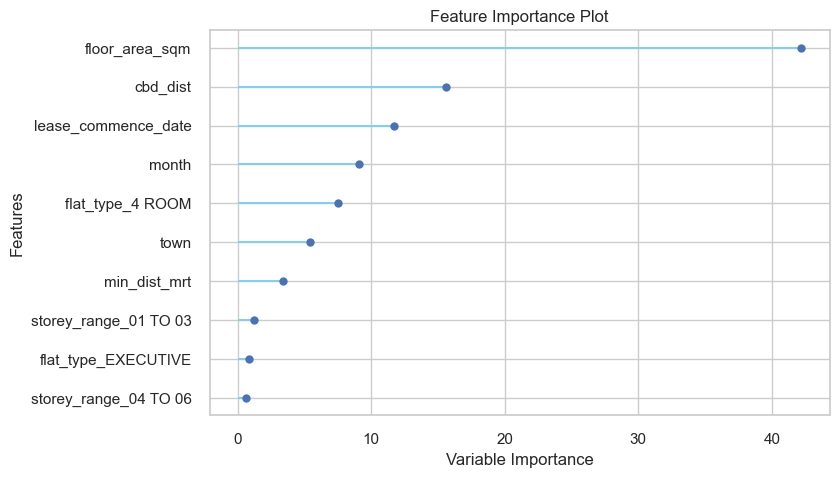

In [81]:
plot_model(tuned_model, plot='feature')

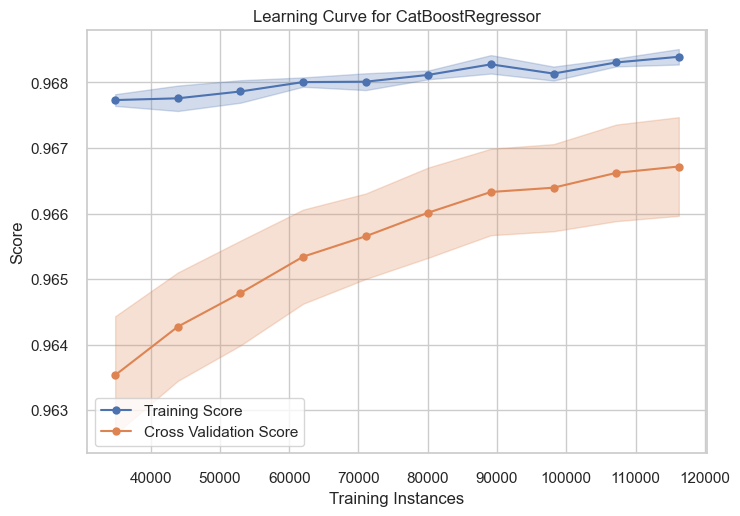

In [82]:
plot_model(tuned_model, plot='learning')

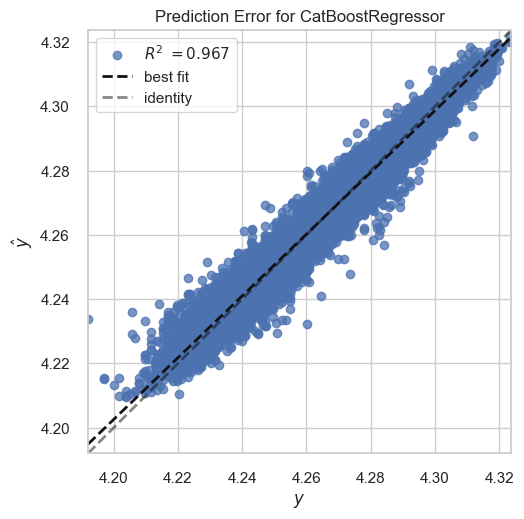

In [83]:
plot_model(tuned_model, plot='error')

In [84]:
evaluate_model(tuned_model)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

## Save model and pipeline

In [85]:
final_best = finalize_model(tuned_model)

save_model(final_best, 'resale_pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=C:\Users\JJYIT~1\AppData\Local\Temp\joblib),
          steps=[('target_transformation',
                  TransformerWrapperWithInverse(transformer=TargetTransformer(estimator=PowerTransformer(standardize=False)))),
                 ('numerical_imputer',
                  TransformerWrapper(include=['floor_area_sqm',
                                              'lease_commence_date', 'cbd_dist',
                                              'min_dist_mrt'],
                                     transformer=Si...
                  TransformerWrapper(include=['town', 'month'],
                                     transformer=TargetEncoder(cols=['town',
                                                                     'month'],
                                                               handle_missing='return_nan'))),
                 ('remove_outliers',
                  TransformerWrapper(transformer=RemoveOutliers(random_state=6239))),
       

In [86]:
resale_pipeline = load_model('resale_pipeline')

Transformation Pipeline and Model Successfully Loaded


In [88]:
resale_pipeline

Pipeline(memory=FastMemory(location=C:\Users\JJYIT~1\AppData\Local\Temp\joblib),
         steps=[('target_transformation',
                 TransformerWrapperWithInverse(transformer=TargetTransformer(estimator=PowerTransformer(standardize=False)))),
                ('numerical_imputer',
                 TransformerWrapper(include=['floor_area_sqm',
                                             'lease_commence_date', 'cbd_dist',
                                             'min_dist_mrt'],
                                    transformer=Si...
                 TransformerWrapper(include=['town', 'month'],
                                    transformer=TargetEncoder(cols=['town',
                                                                    'month'],
                                                              handle_missing='return_nan'))),
                ('remove_outliers',
                 TransformerWrapper(transformer=RemoveOutliers(random_state=6239))),
                ('normalize', TransformerWrapper(transformer=StandardScaler())),
                ('actual_estimator',
                 <catboost.core.CatBoostRegressor object at 0x0000018C860BD1F0>)])

In [89]:
resaledata_unseen = df.copy()
resaledata_unseen.drop(['resale_price', 'block', 'street_name', 'postal_code', 'latitude', 'longitude'], axis = 1, inplace = True)
predictions = predict_model(best, data = resaledata_unseen)

In [61]:
predictions

,town,month,flat_type,storey_range,floor_area_sqm,flat_model,lease_commence_date,cbd_dist,min_dist_mrt,prediction_label
0,ANG MO KIO,2015-01,3 ROOM,07 TO 09,60.0,Improved,1986,10296.855469,1096.947876,277501.40625
1,ANG MO KIO,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1981,10065.227539,847.235718,283506.50000
2,ANG MO KIO,2015-01,3 ROOM,01 TO 03,69.0,New Generation,1980,10118.832031,1176.742188,294933.65625
3,ANG MO KIO,2015-01,3 ROOM,01 TO 03,68.0,New Generation,1979,9383.300781,682.205444,291077.59375
4,ANG MO KIO,2015-01,3 ROOM,07 TO 09,68.0,New Generation,1980,9825.916992,953.047668,302363.18750
...,...,...,...,...,...,...,...,...,...,...
194235,SEMBAWANG,2023-07,4 ROOM,16 TO 18,93.0,Model A,2019,18624.123047,702.591553,597319.43750
194236,SEMBAWANG,2023-07,4 ROOM,04 TO 06,93.0,Model A,2019,18624.123047,702.591553,558244.87500
194237,SEMBAWANG,2023-07,4 ROOM,13 TO 15,93.0,Model A,2019,18223.416016,727.108154,588235.68750
194238,HOUGANG,2023-07,4 ROOM,07 TO 09,93.0,Model A,2019,11650.038086,1278.633545,603665.06250


In [90]:
import mlflow
logged_model = 'runs:/fa2b4cb3b95641928b14f91f8db15dc6/model'

# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)

In [91]:
loaded_model

mlflow.pyfunc.loaded_model:
  artifact_path: model
  flavor: mlflow.sklearn
  run_id: fa2b4cb3b95641928b14f91f8db15dc6